# Introduction

In this notebook, I'm trying to create a general pattern for the perturbation I generated from class 2. The method I tried is feature agglomeration by merging similar features. This approach can be implemented by clustering in the feature direction, in other words clustering the transposed data. For the experiment, I tried clustering of 28 and clustering of 50. Then, I applied my general pattern to a random 2 images. According to the result, clustering of 28 does not perturb the image very well as the classifier is still able to predict 2 correctly as 2. However, with a clustering of 50, it got misclassified as 3 with a good confidence. 

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from sklearn.metrics import confusion_matrix
import time
from datetime import timedelta
import math

In [2]:
tf.__version__

'2.8.0'

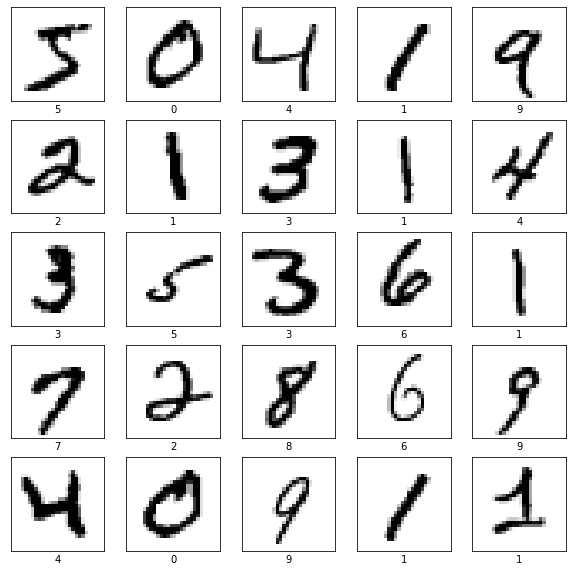

In [3]:
(train_images, train_labels), (test_images, test_labels) = tf.keras.datasets.mnist.load_data()
class_names = ['0', '1', '2', '3', '4',
               '5', '6', '7', '8', '9']

plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(train_images[i], cmap=plt.cm.binary)
    plt.xlabel(class_names[train_labels[i]])
plt.show()

In [4]:
train_images = train_images.reshape(train_images.shape[0], 28, 28)

In [5]:
train_images = train_images.astype('float32')
test_images = test_images.astype('float32')
train_images = train_images / 255.
test_images = test_images / 255.

In [6]:
train_images.shape

(60000, 28, 28)

Text(0.5, 1.0, 'Ground Truth : 7')

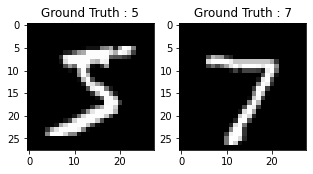

In [7]:
plt.figure(figsize=[5,5])

# Display the first image in training data
plt.subplot(121)
plt.imshow(train_images[0,:,:], cmap='gray')
plt.title("Ground Truth : {}".format(train_labels[0]))

# Display the first image in testing data
plt.subplot(122)
plt.imshow(test_images[0,:,:], cmap='gray')
plt.title("Ground Truth : {}".format(test_labels[0]))

In [8]:
train_images = train_images.reshape(-1, 28, 28, 1)
test_images = test_images.reshape(-1, 28, 28, 1)
train_images.shape, test_images.shape

((60000, 28, 28, 1), (10000, 28, 28, 1))

In [9]:
train_images = train_images.astype('float32')
test_images = test_images.astype('float32')
train_images = train_images / 255.
test_images = test_images / 255.

## One hot encoded vector

In [10]:
from tensorflow.keras.utils import to_categorical
# Change the labels from categorical to one-hot encoding
train_labels_one_hot = to_categorical(train_labels)
test_labels_one_hot = to_categorical(test_labels)

# Display the change for category label using one-hot encoding
print('Original label:', train_labels[0])
print('After conversion to one-hot:', train_labels_one_hot[0])

Original label: 5
After conversion to one-hot: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]


In [11]:
train_labels_one_hot

array([[0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.]], dtype=float32)

In [12]:
from sklearn.model_selection import train_test_split
train_X, valid_X, train_label, valid_label = train_test_split(train_images, train_labels_one_hot, test_size=0.1, random_state=13)

In [13]:
train_X.shape

(54000, 28, 28, 1)

## CNN Model

In [14]:
import keras
from keras.models import Sequential,Input,Model
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D

In [15]:
batch_size = 64
epochs = 10
num_classes = 10

In [16]:
mnist_model = Sequential()
mnist_model.add(Conv2D(32, kernel_size=(3, 3),activation='linear',padding='same',input_shape=(28,28,1)))
mnist_model.add(MaxPooling2D((2, 2),padding='same'))
mnist_model.add(Conv2D(64, (3, 3), activation='linear',padding='same'))
mnist_model.add(MaxPooling2D(pool_size=(2, 2),padding='same'))
mnist_model.add(Flatten())
mnist_model.add(Dense(128, activation='linear'))
mnist_model.add(Dense(num_classes, activation='softmax'))

2022-08-16 16:06:54.807794: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [17]:

# mnist_model.compile(loss=keras.losses.SparseCategoricalCrossentropy, optimizer=tf.keras.optimizers.Adam(),metrics=['accuracy'])


mnist_model.compile(loss=keras.losses.categorical_crossentropy, optimizer=tf.keras.optimizers.Adam(),metrics=['accuracy'])

In [18]:
mnist_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 28, 28, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 7, 7, 64)         0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 3136)              0         
                                                                 
 dense (Dense)               (None, 128)               4

In [19]:
mnist_train = mnist_model.fit(train_X, train_label, batch_size=batch_size,epochs=epochs,verbose=1,validation_data=(valid_X, valid_label))

Epoch 1/10
844/844 [==============================] - 33s 39ms/step - loss: 0.4580 - accuracy: 0.8579 - val_loss: 0.1745 - val_accuracy: 0.9480
Epoch 2/10
844/844 [==============================] - 33s 39ms/step - loss: 0.1386 - accuracy: 0.9586 - val_loss: 0.1054 - val_accuracy: 0.9692
Epoch 3/10
844/844 [==============================] - 32s 38ms/step - loss: 0.0926 - accuracy: 0.9727 - val_loss: 0.0879 - val_accuracy: 0.9735
Epoch 4/10
844/844 [==============================] - 31s 37ms/step - loss: 0.0749 - accuracy: 0.9771 - val_loss: 0.0735 - val_accuracy: 0.9775
Epoch 5/10
844/844 [==============================] - 29s 34ms/step - loss: 0.0638 - accuracy: 0.9805 - val_loss: 0.0792 - val_accuracy: 0.9762
Epoch 6/10
844/844 [==============================] - 29s 35ms/step - loss: 0.0567 - accuracy: 0.9825 - val_loss: 0.0663 - val_accuracy: 0.9805
Epoch 7/10
844/844 [==============================] - 30s 35ms/step - loss: 0.0522 - accuracy: 0.9841 - val_loss: 0.0611 - val_accuracy:

In [20]:
test_eval = mnist_model.evaluate(test_images, test_labels_one_hot, verbose=0)

In [21]:
test_eval = mnist_model.evaluate(test_images, test_labels_one_hot, verbose=0)
print('Test loss:', test_eval[0])
print('Test accuracy:', test_eval[1])

Test loss: 0.04569295048713684
Test accuracy: 0.9846000075340271


In [22]:
# from sklearn.metrics import classification_report
# import numpy as np

# class_names = ['0', '1', '2', '3', '4',
#                '5', '6', '7', '8', '9']
# class_names[train_labels[0]]

# Y_test = np.argmax(class_names) # Convert one-hot to index
# y_pred = mnist_model.predict(test_images)
# print(classification_report(Y_test, y_pred))

## get class label methods

In [23]:
class_names = ['0', '1', '2', '3', '4',
               '5', '6', '7', '8', '9']
class_names[train_labels[20]]

'4'

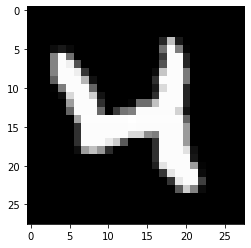

In [24]:
plt.imshow(train_images[20],cmap='gray')

9


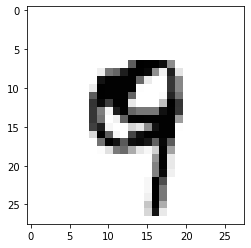

In [25]:
image_index = 4444
plt.imshow(test_images[image_index].reshape(28, 28),cmap='Greys')
pred = mnist_model.predict(test_images[image_index].reshape(1, 28, 28, 1))
print(pred.argmax())

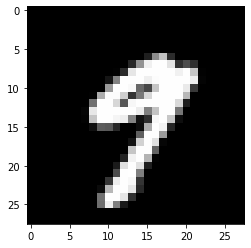

In [26]:
plt.imshow(test_images[20],cmap='gray')

In [27]:
img1 = test_images[1]
img1 = (np.expand_dims(img1,0))
img1.shape
img1 = tf.convert_to_tensor(img1, dtype=tf.float32)

In [28]:
img2 = test_images[0]
img2 = (np.expand_dims(img2,0))
img2.shape

(1, 28, 28, 1)

In [29]:
test_labels[0]

7

In [30]:
mnist_model(img2)

<tf.Tensor: shape=(1, 10), dtype=float32, numpy=
array([[7.6388224e-10, 1.0938670e-08, 1.4882694e-06, 2.5091888e-06,
        7.0372018e-13, 9.0113478e-10, 3.1649833e-17, 9.9999583e-01,
        3.8252876e-09, 1.9570200e-07]], dtype=float32)>

In [31]:
prediction2 = mnist_model.predict(img2)
prediction2

array([[7.6388224e-10, 1.0938670e-08, 1.4882694e-06, 2.5091888e-06,
        7.0372018e-13, 9.0113478e-10, 3.1649833e-17, 9.9999583e-01,
        3.8252876e-09, 1.9570200e-07]], dtype=float32)

In [32]:
prediction2[0]

array([7.6388224e-10, 1.0938670e-08, 1.4882694e-06, 2.5091888e-06,
       7.0372018e-13, 9.0113478e-10, 3.1649833e-17, 9.9999583e-01,
       3.8252876e-09, 1.9570200e-07], dtype=float32)

In [33]:
100*np.max(prediction2)

99.99958276748657

In [34]:
label = np.argmax(mnist_model.predict(img2)[0])
label

7

# Get labels and images of all class 2 

#### indices of class 2

In [35]:
indices_of_2 = [i for i in range(len(test_images)) if class_names[test_labels[i]] == '2']
print('Found', len(indices_of_2), 'twos')
print(indices_of_2[:20])

Found 1032 twos
[1, 35, 38, 43, 47, 72, 77, 82, 106, 119, 147, 149, 172, 174, 186, 199, 208, 221, 222, 225]


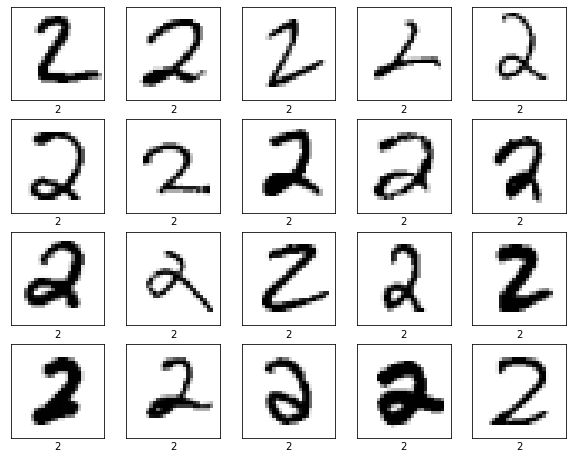

In [36]:
plt.figure(figsize=(10,10))
for i in range(20):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(test_images[indices_of_2[i]], cmap=plt.cm.binary)
    plt.xlabel(class_names[test_labels[indices_of_2[i]]])
plt.show()

#### images of class 2

In [37]:
images_of_2 = [test_images[i] for i in indices_of_2]
len(images_of_2)

1032

In [38]:
images_of_2[0].shape

(28, 28, 1)

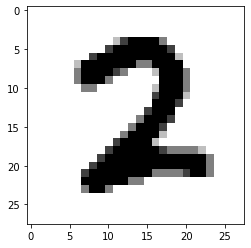

In [39]:
plt.imshow(images_of_2[1031], cmap=plt.cm.binary)

In [40]:
# expand the dimension to (1,28,28,1)
for i in range(len(images_of_2)):
    img2= images_of_2[i]
    images_of_2[i] = (np.expand_dims(img2,0))
#     print(images_of_2[i].shape)
    images_of_2[i]= tf.convert_to_tensor(images_of_2[i], dtype=tf.float32)

In [41]:
images_of_2[1031]

<tf.Tensor: shape=(1, 28, 28, 1), dtype=float32, numpy=
array([[[[0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ]],

        [[0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],

# Create Prediction of all class 2

In [42]:
prediction_of_2 = [mnist_model.predict(images_of_2[i]) for i in range(len(images_of_2))]

In [43]:
prediction_of_2[1031]

array([[4.9386531e-13, 7.4977205e-11, 1.0000000e+00, 3.2996733e-10,
        9.1245656e-18, 6.5744817e-19, 6.1773823e-18, 2.6305321e-11,
        4.1357032e-10, 6.1979747e-15]], dtype=float32)

In [44]:
100*np.max(prediction_of_2[1031])

100.0

In [45]:
label = np.argmax(mnist_model.predict(images_of_2[1031])[0])
label

2

# creating adversarial example with [2]

In [46]:
# create adversarial pattern with Cross Entropy loss func and the gradient
loss_object = tf.keras.losses.CategoricalCrossentropy()

def create_adversarial_pattern(input_image, input_label, model):
    with tf.GradientTape() as tape:
        tape.watch(input_image)
        prediction = model(input_image)
        loss = loss_object(input_label, prediction)
#         print(loss)

  # Get the gradients of the loss w.r.t to the input image.
    gradient = tape.gradient(loss, input_image)
  # Get the sign of the gradients to create the perturbation
    signed_grad = tf.sign(gradient)
    return signed_grad


In [48]:
label_of_2 = [tf.one_hot(1, prediction_of_2[i].shape[-1]) for i in range(len(images_of_2))]
label_of_2 = [tf.reshape(label_of_2[i], (1, prediction_of_2[i].shape[-1])) for i in range(len(images_of_2))]
# prediction_of_2

In [49]:
label_of_2

[<tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 10), dtype=float32, numpy=array([[0., 1., 0., 0.,

In [50]:
perturbations_of_2 = [create_adversarial_pattern(images_of_2[i], label_of_2[i], mnist_model) 
                      for i in range(len(images_of_2))]

In [51]:
perturbations_of_2[1031][0]

<tf.Tensor: shape=(28, 28, 1), dtype=float32, numpy=
array([[[ 1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [-1.],
        [-1.],
        [ 1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.]],

       [[ 1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [-1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.]],

       [[ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.]

In [52]:
perturbations_of_2

[<tf.Tensor: shape=(1, 28, 28, 1), dtype=float32, numpy=
 array([[[[ 1.],
          [-1.],
          [-1.],
          [-1.],
          [-1.],
          [-1.],
          [-1.],
          [-1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [-1.],
          [-1.],
          [-1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [-1.],
          [-1.],
          [ 1.],
          [-1.],
          [-1.],
          [-1.],
          [-1.],
          [-1.]],
 
         [[ 1.],
          [-1.],
          [-1.],
          [ 1.],
          [ 1.],
          [-1.],
          [-1.],
          [-1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [-1.],
          [-1.],
          [-1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [ 1.],
          [-1.],
          [-1.],
          [-1.],
     

In [53]:
# perturbations_of_2.shape

In [54]:
# plt.imshow(perturbations_of_2[1031][0])

In [55]:
# plt.imshow(images_of_2[1031], cmap=plt.cm.binary)

In [56]:
# test_image_after_perturb = images_of_2[1031] + 

In [57]:
perturbations_of_2[i][0].numpy()

array([[[ 1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [-1.],
        [-1.],
        [ 1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.]],

       [[ 1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [-1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [-1.],
        [-1.],
        [-1.],
        [-1.]],

       [[ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
        [ 1.],
      

In [58]:
img_perturbation = perturbations_of_2[1031][0].numpy()

In [59]:
img_perturbation.shape

(28, 28, 1)

In [60]:
# img_perturbation.numpy()
img_perturbation = np.squeeze(img_perturbation)
# img_perturbation.reshape(28,28)
img_perturbation.shape

(28, 28)

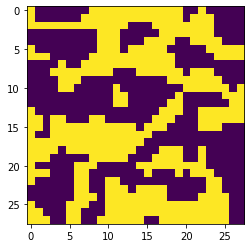

In [61]:
plt.imshow(img_perturbation)

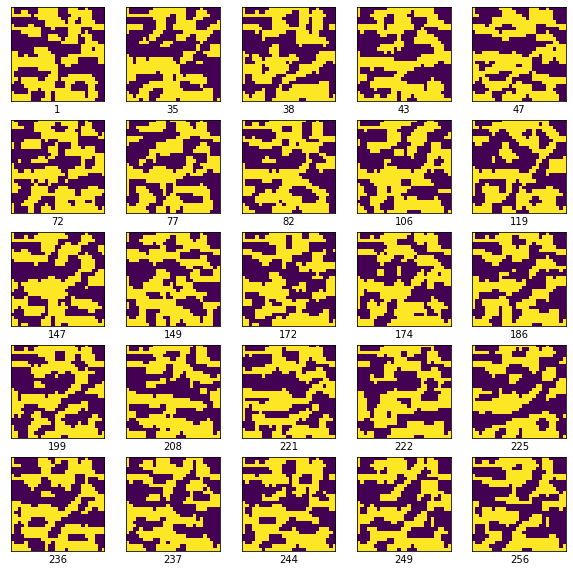

In [62]:
# 25 perturbations of class 2
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(perturbations_of_2[i][0] * 0.05 + 0.05)
    plt.xlabel(indices_of_2[i])
plt.show()

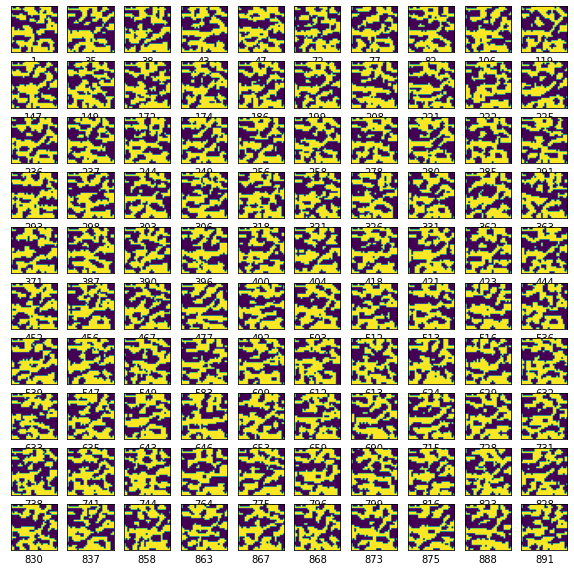

In [63]:
# 100 perturbation of class 2
plt.figure(figsize=(10,10))
for i in range(100):
    plt.subplot(10,10,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(perturbations_of_2[i][0] * 0.05 + 0.05)
    plt.xlabel(indices_of_2[i])
plt.show()

# Generate Common Perturbation of Class 2

Other possible methods: MSE, K means, Feature Matching using OpenCV, any distance(manhattan, jacobina, ..)
something unsupervised

In [64]:
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.inception_v3 import preprocess_input, decode_predictions
import numpy as np
import os
import matplotlib.pyplot as plt
import cv2
# from google.colab.patches import cv2_imshow

In [66]:
two = images_of_2[1031]
two

<tf.Tensor: shape=(1, 28, 28, 1), dtype=float32, numpy=
array([[[[0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ]],

        [[0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],
         [0.        ],

In [71]:
two = np.squeeze(two)
two.shape

(28, 28)

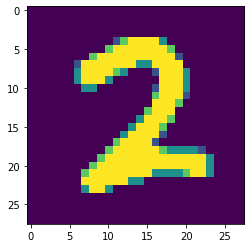

In [72]:
plt.imshow(two)

In [74]:
shap_heatmap = np.zeros((28,28))
pants_shaps = two
pants_shaps.shape

for i in range(len(pants_shaps)):
    shap_heatmap += pants_shaps[i,0]
    

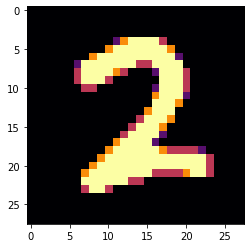

In [76]:
plt.imshow(two, cmap='inferno')
plt.show()

# Feature Agglomeration

merge together similar features: feature agglomeration. This approach can be implemented by clustering in the feature direction, in other words clustering the transposed data.

### feature agglomeration with clustering = 28

In [314]:
perturbation_of_2_np = [perturbations_of_2[i][0].numpy() for i in range(1031)]

In [321]:
perturbation_of_2_np[0][0].shape

(28, 1)

In [324]:
perturbation_of_2_squeeze = np.squeeze(perturbations_of_2)

In [325]:
perturbation_of_2_squeeze.shape

(1032, 28, 28)

In [387]:
## Agglo alog
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

X = np.reshape(perturbation_of_2_squeeze, (len(perturbation_of_2_squeeze), -1))
connectivity = grid_to_graph(*perturbation_of_2_squeeze[0].shape)
agglo = cluster.FeatureAgglomeration(connectivity=connectivity,
                                     n_clusters=28)
agglo.fit(X)
X_reduced = agglo.transform(X)

X_restored = agglo.inverse_transform(X_reduced)
images_restored = np.reshape(X_restored, perturbation_of_2_squeeze.shape)

In [380]:
images_restored.shape

(1032, 28, 28)

### Sample perturbation after feature agglomeration

In [356]:
images_restored[0].shape

(28, 28)

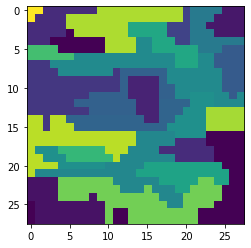

In [390]:
plt.imshow(images_restored[1])

In [391]:
sample_perturbation = images_restored[1]

In [400]:
sample_perturbation.shape

(28, 28)

In [401]:
sample_perturbation = sample_perturbation.reshape(1, 28, 28, 1)

In [402]:
sample_perturbation= tf.convert_to_tensor(sample_perturbation, dtype=tf.float32)

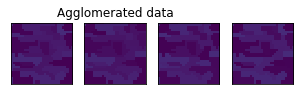

In [412]:
plt.figure(1, figsize=(4, 3.5))
plt.clf()
plt.subplots_adjust(left=.01, right=.99, bottom=.01, top=.91)
for i in range(4):
#     plt.subplot(3, 4, i + 1)
#     plt.imshow(images[i], cmap=plt.cm.gray, vmax=16, interpolation='nearest')
#     plt.xticks(())
#     plt.yticks(())
#     if i == 1:
#         plt.title('Original data')
    plt.subplot(3, 4, 4 + i + 1)
    plt.imshow(images_restored[i], vmax=16,
               interpolation='nearest')
    if i == 1:
        plt.title('Agglomerated data')
    plt.xticks(())
    plt.yticks(())

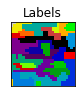

In [410]:
plt.subplot(3, 4, 10)
plt.imshow(np.reshape(agglo.labels_, perturbation_of_2_squeeze[0].shape),
           interpolation='nearest', cmap=plt.cm.nipy_spectral)
plt.xticks(())
plt.yticks(())
plt.title('Labels')

plt.show()

In [420]:
plt_imgs = np.reshape(agglo.labels_, perturbation_of_2_squeeze[0].shape)

In [421]:
plt_imgs.shape

(28, 28)

In [422]:
plt_imgs = plt_imgs.reshape(1, 28, 28, 1)

In [423]:
plt_imgs= tf.convert_to_tensor(plt_imgs, dtype=tf.float32)

### Apply perturbation to a random 2

In [403]:
mnist_model.predict(images_of_2[0]+ 0.01*sample_perturbation)

array([[0., 0., 1., 0., 0., 0., 0., 0., 0., 0.]], dtype=float32)

In [407]:
def display_images(image, description):
    prediction = mnist_model.predict(image)
#     prediction = prediction[0]
    acc = 100*np.max(prediction)
    label = np.argmax(mnist_model.predict(image)[0])
        
    plt.figure()
    plt.imshow(image[0]*0.5+0.5)
    plt.title('{} \n {} : {:.2f}% Confidence'.format(description,
                                                   label, acc))
    plt.show()

#### with smaple_perturbation

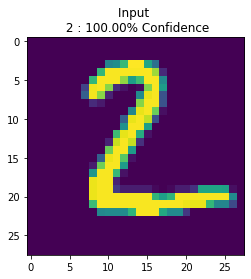

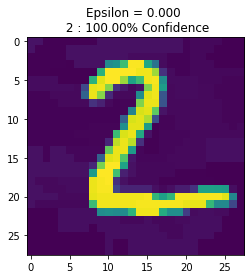

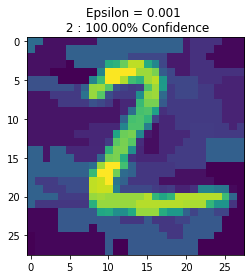

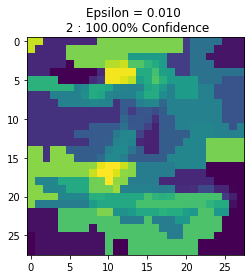

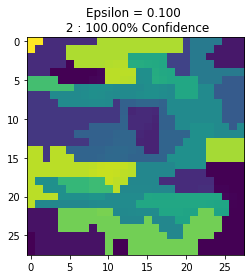

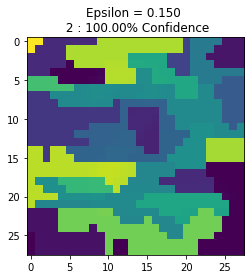

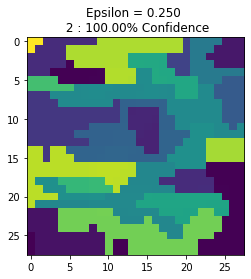

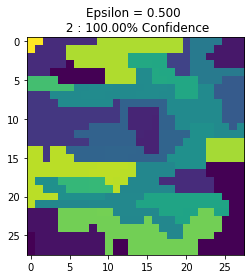

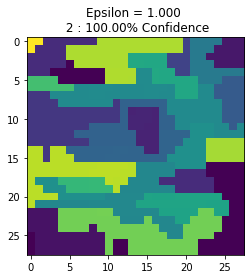

In [445]:
epsilons = [0, 0.0001, 0.001, 0.01, 0.1, 0.15, 0.25, 0.5, 1]
descriptions = [('Epsilon = {:0.3f}'.format(eps) if eps else 'Input')
                for eps in epsilons]

for i, eps in enumerate(epsilons):
    adv_x = images_of_2[0] + eps*sample_perturbation
#     adv_x = tf.clip_by_value(adv_x, -1, 1)
#     image_index = 
    display_images(adv_x, descriptions[i])
#     print(adv_x)


# Trying out different n_clusters numbers

### feature agglomeration with clustering = 50

In [428]:
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()
agglo_50 = cluster.FeatureAgglomeration(connectivity=connectivity,
                                     n_clusters=50)

agglo_50.fit(X)
X_reduced_50 = agglo_50.transform(X)

X_restored_50 = agglo_50.inverse_transform(X_reduced_50)
images_restored_50 = np.reshape(X_restored_50, perturbation_of_2_squeeze.shape)

In [430]:
images_restored_50.shape

(1032, 28, 28)

### Sample perturbation after feature agglomeration

In [431]:
images_restored_50[0].shape

(28, 28)

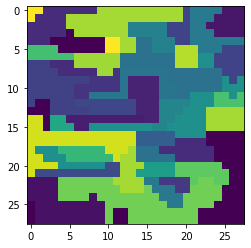

In [432]:
plt.imshow(images_restored_50[1])

In [433]:
sample_perturbation_50 = images_restored_50[1]

In [434]:
sample_perturbation_50.shape

(28, 28)

In [435]:
sample_perturbation_50 = sample_perturbation_50.reshape(1, 28, 28, 1)

In [436]:
sample_perturbation_50= tf.convert_to_tensor(sample_perturbation_50, dtype=tf.float32)

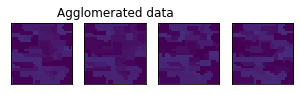

In [437]:
plt.figure(1, figsize=(4, 3.5))
plt.clf()
plt.subplots_adjust(left=.01, right=.99, bottom=.01, top=.91)
for i in range(4):
#     plt.subplot(3, 4, i + 1)
#     plt.imshow(images[i], cmap=plt.cm.gray, vmax=16, interpolation='nearest')
#     plt.xticks(())
#     plt.yticks(())
#     if i == 1:
#         plt.title('Original data')
    plt.subplot(3, 4, 4 + i + 1)
    plt.imshow(images_restored_50[i], vmax=16,
               interpolation='nearest')
    if i == 1:
        plt.title('Agglomerated data')
    plt.xticks(())
    plt.yticks(())

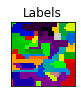

In [438]:
plt.subplot(3, 4, 10)
plt.imshow(np.reshape(agglo_50.labels_, perturbation_of_2_squeeze[0].shape),
           interpolation='nearest', cmap=plt.cm.nipy_spectral)
plt.xticks(())
plt.yticks(())
plt.title('Labels')

plt.show()

In [439]:
plt_imgs_50 = np.reshape(agglo_50.labels_, perturbation_of_2_squeeze[0].shape)

In [440]:
plt_imgs_50.shape

(28, 28)

In [441]:
plt_imgs_50 = plt_imgs.reshape(1, 28, 28, 1)

In [442]:
plt_imgs_50= tf.convert_to_tensor(plt_imgs_50, dtype=tf.float32)

### Apply perturbation to a random 2

In [443]:
def display_images(image, description):
    prediction = mnist_model.predict(image)
#     prediction = prediction[0]
    acc = 100*np.max(prediction)
    label = np.argmax(mnist_model.predict(image)[0])
        
    plt.figure()
    plt.imshow(image[0]*0.5+0.5)
    plt.title('{} \n {} : {:.2f}% Confidence'.format(description,
                                                   label, acc))
    plt.show()

##### with plt_imgs of 50

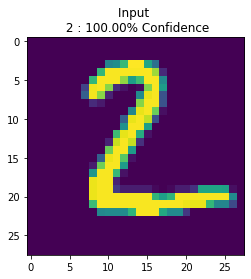

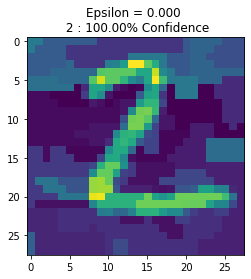

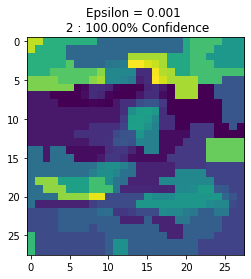

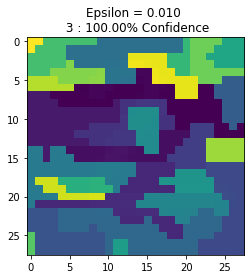

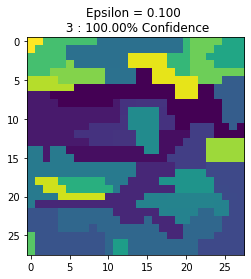

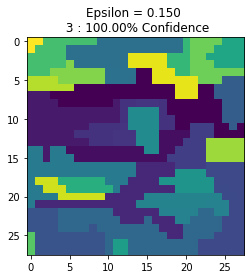

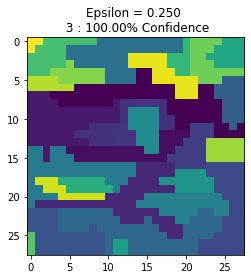

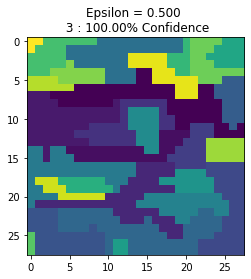

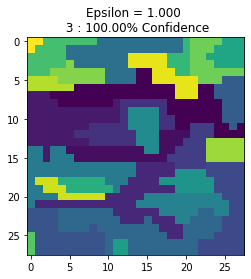

In [450]:
epsilons = [0, 0.0001, 0.001, 0.01, 0.1, 0.15, 0.25, 0.5, 1]
descriptions = [('Epsilon = {:0.3f}'.format(eps) if eps else 'Input')
                for eps in epsilons]

for i, eps in enumerate(epsilons):
    adv_x = images_of_2[0] + eps*plt_imgs_50
#     adv_x = tf.clip_by_value(adv_x, -1, 1)
#     image_index = 
    display_images(adv_x, descriptions[i])
#     print(adv_x)
